<a href="https://colab.research.google.com/github/adewoleopeyemi/Deep-Dream/blob/master/NeuralStyleTransfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving target.png to target.png


In [ ]:
target_image = uploaded["target.png"]

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving style_reference_image.png to style_reference_image.png


In [ ]:
style_reference_image = uploaded['style_reference_image.png']

In [ ]:
from PIL import Image
import io

In [ ]:
target_image = Image.open(io.BytesIO(target_image))
style_reference_image = Image.open(io.BytesIO(style_reference_image))

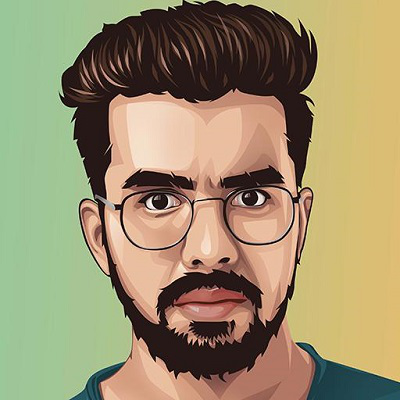

In [ ]:
style_reference_image

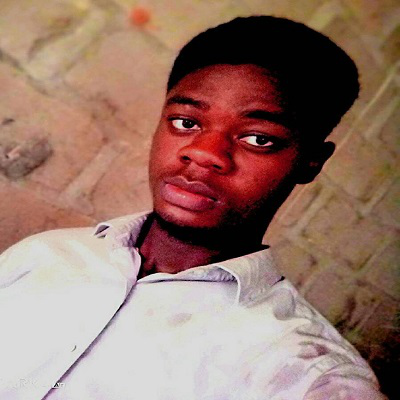

In [ ]:
target_image

In [ ]:
import numpy as np
from keras.applications import vgg19
from keras.preprocessing import image as imagek


def preprocess_image(image):
  img = imagek.img_to_array(image)
  img = np.expand_dims(img, axis = 0)
  img = vgg19.preprocess_input(img)
  return img


def deprocess_image(x):
  #Zero-centering by removing the mean pixel value from imagenet.This 
  #reverse a transformation done by vg19.preprocess_input
  x[:, :, 0] += 103.939
  x[:, :, 1] +=116.779
  x[:, :, 2] += 123.68
  x = x[:, :, ::-1]
  x = np.clip(x, 0, 255).astype("uint8")
  return x

Using TensorFlow backend.


In [ ]:
from keras import backend as K

target_image = preprocess_image(target_image)
style_image = preprocess_image(style_reference_image)

target_images = K.constant(target_image)
style_images = K.constant(style_image)
#placeholder for generated image
combination_image = K.placeholder((1, 400, 400, 3))


#Combines the three images into a single batch
input_tensor = K.concatenate([target_images, style_images, combination_image], axis = 0)

model = vgg19.VGG19(input_tensor = input_tensor, 
                    weights = "imagenet", 
                    include_top =False)


80142336/80134624 [==============================] - 3s 0us/step


In [ ]:
#Content loss
def content_loss(base, combination):
  return K.sum(K.square(combination - base))

#gram matrix
def gram_matrix(x):
  features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
  gram = K.dot(features, K.transpose(features))
  return gram

#style_loss 
def style_loss(style, combination):
  s = gram_matrix(style)
  c = gram_matrix(combination)
  channels = 3
  size = 400 * 400
  return K.sum(K.square(s-c))/ (4 * (channels ** 2) * (size ** 2))



In [ ]:
def total_variational_loss(x):
  a = K.square(
      x[:, :399, :399, :] - 
      x[:, 1:, :399, :])
  b =  K.square(
      x[:, :399, :399, :] - 
      x[:, :399, 1:, :])
  return K.sum(K.pow(a+b, 1.25))

In [ ]:
#Dictionary that maps names to activation tensors
output_dicts = dict([(layer.name, layer.output) for layer in model.layers])

#layer used for content_loss
content_layer = "block5_conv2"
style_layers = ["block1_conv1",
                "block2_conv2",
                "block3_conv1", 
                "block4_conv1",
                "block5_conv1"
]

#weight in the weighted average of the loss components
total_variational_weight = 1e-4
style_weight = 1.2
content_weight = 0.2

loss = K.variable(0.)
layer_features = output_dicts[content_layer]
target_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :]
loss = content_weight * content_loss(target_image_features, combination_features)

for layer_name in style_layers:
  layer_features = output_dicts[layer_name]
  style_reference_features = layer_features[1, :, :, :]
  combination_features = layer_features[2, :, :, :]
  sl = style_loss(style_reference_features, combination_features)
  loss += (style_weight / len(style_layers)) * sl

loss += total_variational_weight * total_variational_loss(combination_image)

In [ ]:
grads = K.gradients(loss, combination_image)[0]
fetch_loss_and_grads = K.function([combination_image], (loss, grads))

class Evaluator(object):

  def __init__(self):
    self.loss_value = None
    self.grads_value = None

  def loss(self, x):
    assert self.loss_value is None
    x = x.reshape((1, 400, 400, 3))
    outs = fetch_loss_and_grads([x])
    loss_value = outs[0]
    grads_value = outs[1].flatten().astype("float64")
    self.loss_value = loss_value
    self.grads_value = grads_value
    return self.loss_value

  def grads(self, x):
    assert self.loss_value is not None
    grads_value = np.copy(self.grads_value)
    self.loss_value = None
    self.grads_value = None
    return grads_value

evaluator = Evaluator()

(480000,)
Start of iteration.  0
Current loss value:  5712029000.0


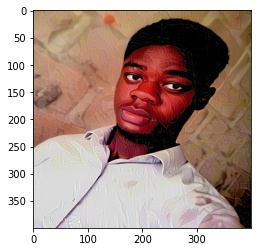

Start of iteration.  1
Current loss value:  2072962000.0


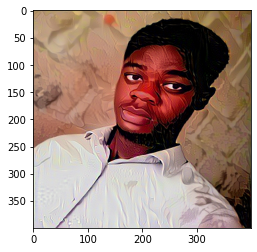

Start of iteration.  2
Current loss value:  1395551500.0


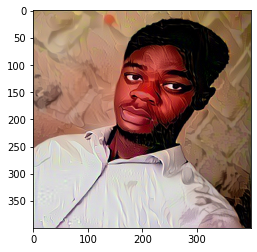

Start of iteration.  3
Current loss value:  1006270340.0


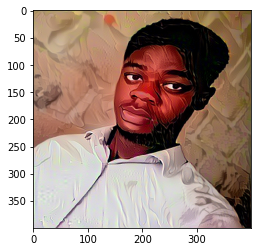

Start of iteration.  4
Current loss value:  830651400.0


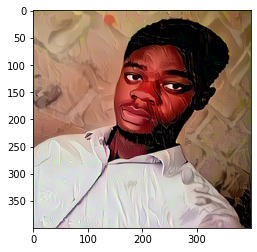

Start of iteration.  5
Current loss value:  736042750.0


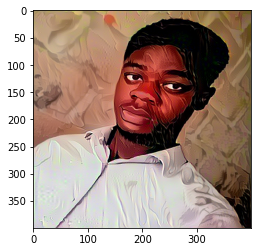

Start of iteration.  6
Current loss value:  660026200.0


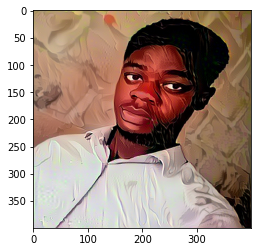

Start of iteration.  7
Current loss value:  599344260.0


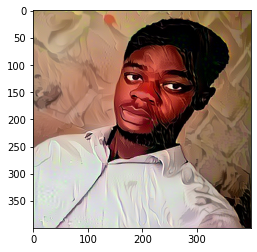

Start of iteration.  8
Current loss value:  561104800.0


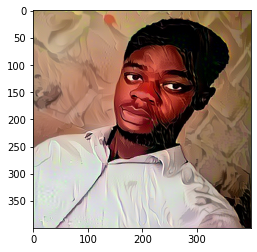

Start of iteration.  9
Current loss value:  523248700.0


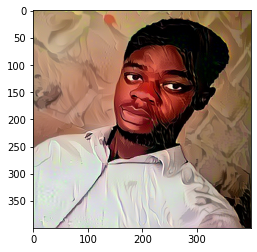

Start of iteration.  10
Current loss value:  493732220.0


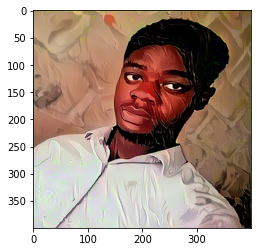

Start of iteration.  11
Current loss value:  473284160.0


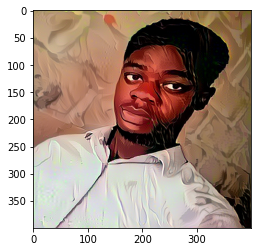

Start of iteration.  12
Current loss value:  452644830.0


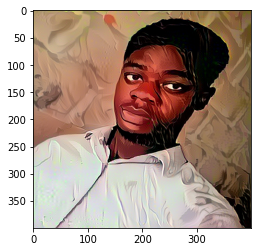

Start of iteration.  13
Current loss value:  436209900.0


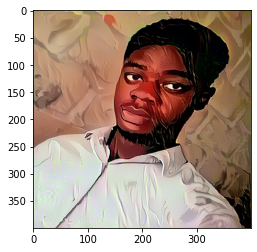

Start of iteration.  14
Current loss value:  423141660.0


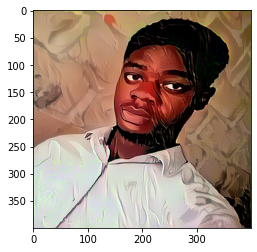

Start of iteration.  15
Current loss value:  408789730.0


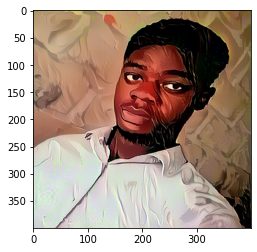

Start of iteration.  16
Current loss value:  395511460.0


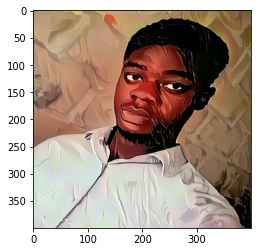

Start of iteration.  17
Current loss value:  385229730.0


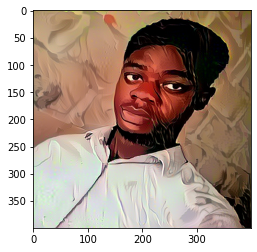

Start of iteration.  18
Current loss value:  375396540.0


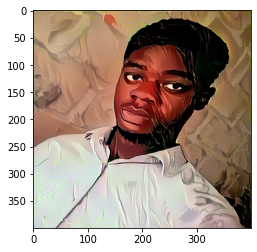

Start of iteration.  19
Current loss value:  367016200.0


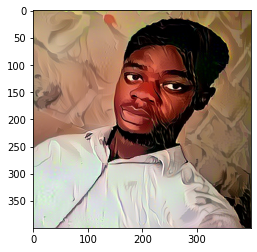

Start of iteration.  20
Current loss value:  359397760.0


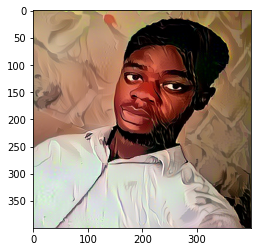

Start of iteration.  21
Current loss value:  351623520.0


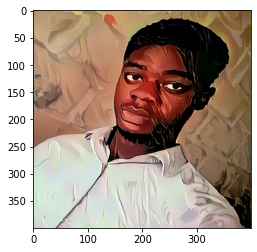

Start of iteration.  22
Current loss value:  345016350.0


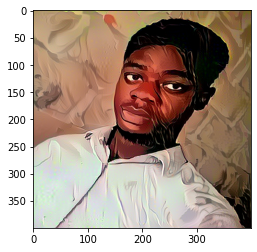

Start of iteration.  23
Current loss value:  338883260.0


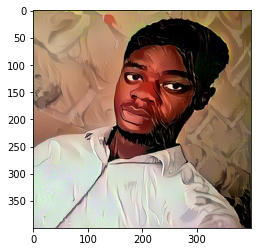

Start of iteration.  24
Current loss value:  333399900.0


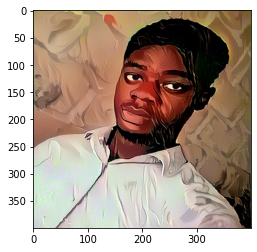

Start of iteration.  25
Current loss value:  327524350.0


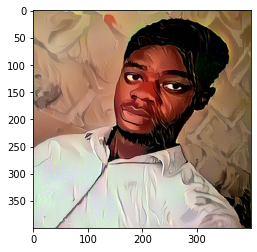

Start of iteration.  26
Current loss value:  322324960.0


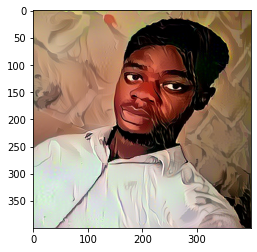

Start of iteration.  27
Current loss value:  316571740.0


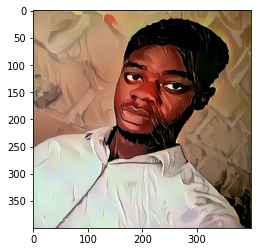

Start of iteration.  28
Current loss value:  311167940.0


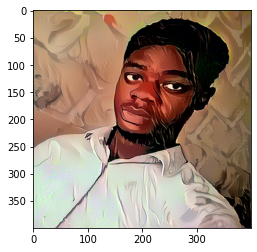

Start of iteration.  29
Current loss value:  306546600.0


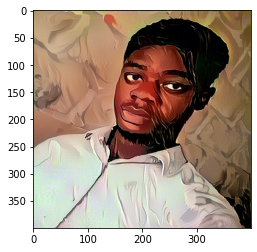

Start of iteration.  30
Current loss value:  302392160.0


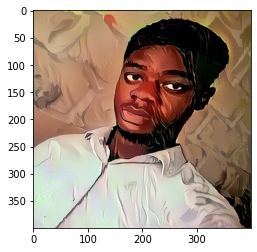

Start of iteration.  31
Current loss value:  299574200.0


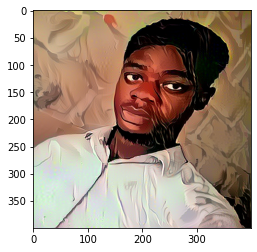

Start of iteration.  32
Current loss value:  296147600.0


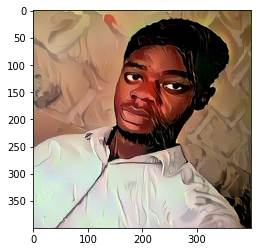

Start of iteration.  33
Current loss value:  293419100.0


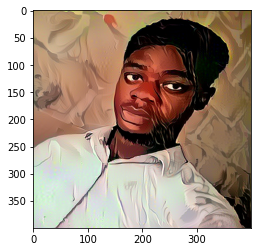

Start of iteration.  34
Current loss value:  289755330.0


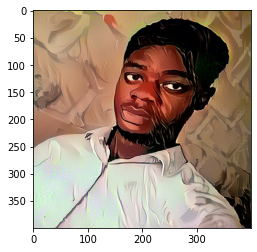

Start of iteration.  35
Current loss value:  286334700.0


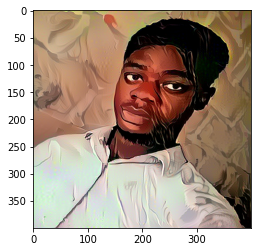

Start of iteration.  36
Current loss value:  283307170.0


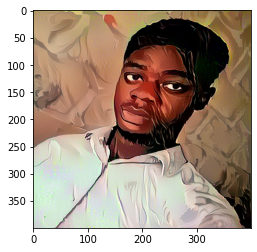

Start of iteration.  37
Current loss value:  280151500.0


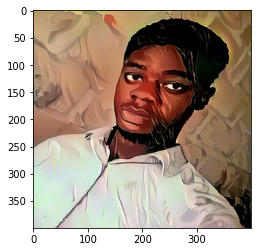

Start of iteration.  38
Current loss value:  277675100.0


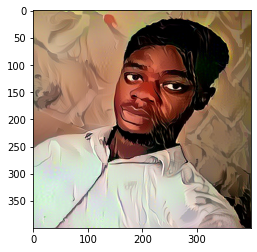

Start of iteration.  39
Current loss value:  275285980.0


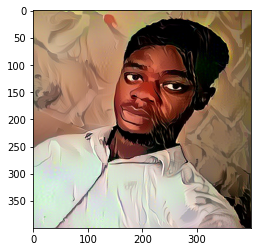

Start of iteration.  40
Current loss value:  272051040.0


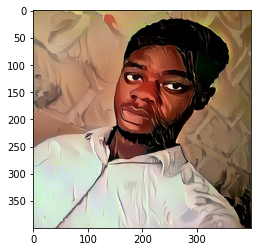

Start of iteration.  41
Current loss value:  269435800.0


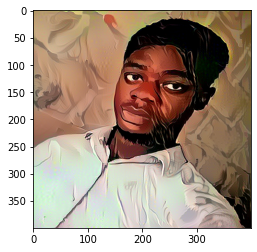

Start of iteration.  42
Current loss value:  267318060.0


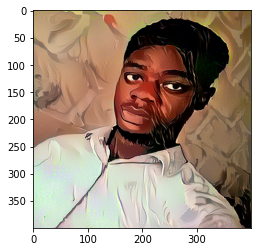

Start of iteration.  43
Current loss value:  265066270.0


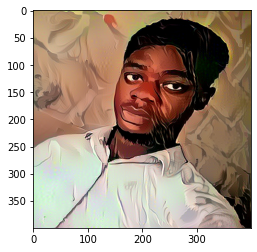

Start of iteration.  44
Current loss value:  263143410.0


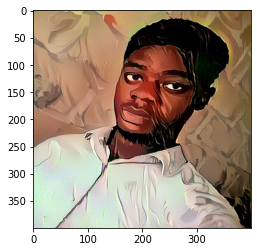

Start of iteration.  45
Current loss value:  261381760.0


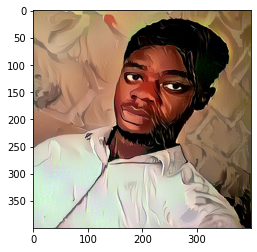

Start of iteration.  46
Current loss value:  259524370.0


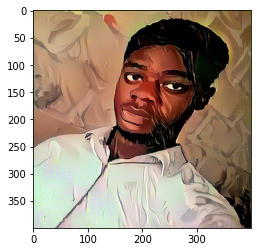

Start of iteration.  47
Current loss value:  257656500.0


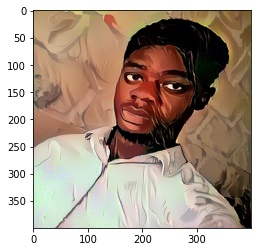

Start of iteration.  48
Current loss value:  255456540.0


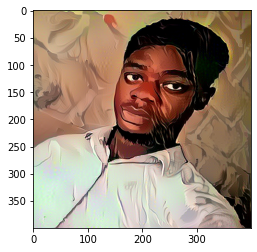

Start of iteration.  49
Current loss value:  253398510.0


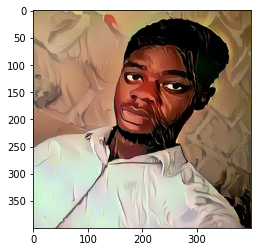

Start of iteration.  50
Current loss value:  251535780.0


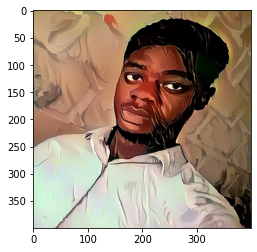

Start of iteration.  51
Current loss value:  249796320.0


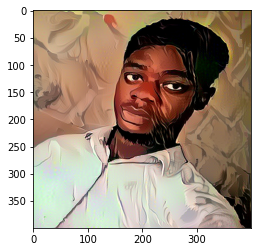

Start of iteration.  52
Current loss value:  248234510.0


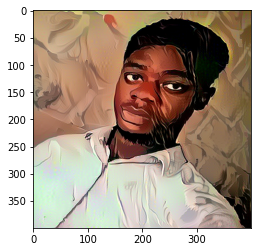

Start of iteration.  53
Current loss value:  246285890.0


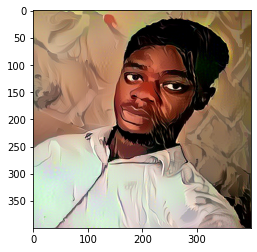

Start of iteration.  54
Current loss value:  244709260.0


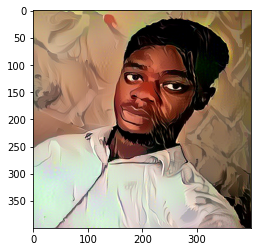

Start of iteration.  55
Current loss value:  243477280.0


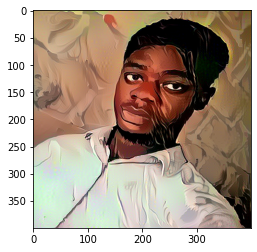

Start of iteration.  56
Current loss value:  241932910.0


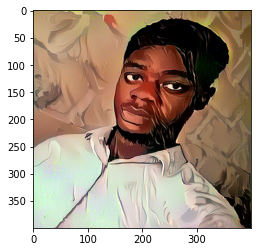

Start of iteration.  57
Current loss value:  240389490.0


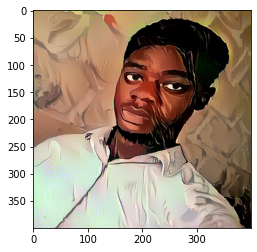

Start of iteration.  58
Current loss value:  238857660.0


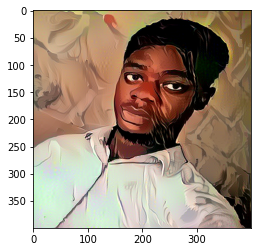

Start of iteration.  59
Current loss value:  237347550.0


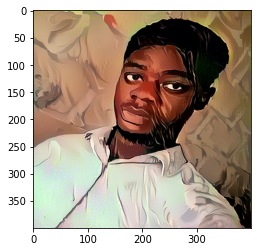

Start of iteration.  60
Current loss value:  236037760.0


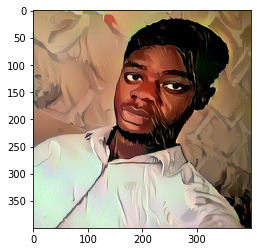

Start of iteration.  61
Current loss value:  234901400.0


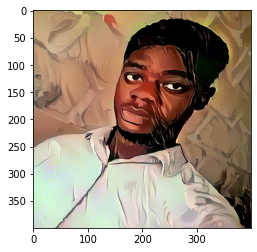

Start of iteration.  62
Current loss value:  233648820.0


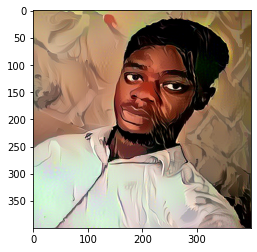

Start of iteration.  63
Current loss value:  232492500.0


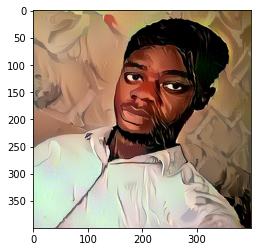

Start of iteration.  64
Current loss value:  231490290.0


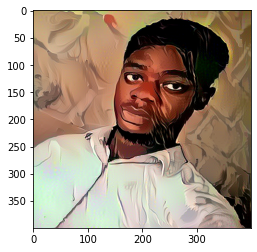

Start of iteration.  65
Current loss value:  230389180.0


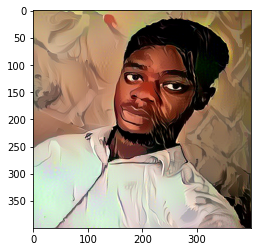

Start of iteration.  66
Current loss value:  229452300.0


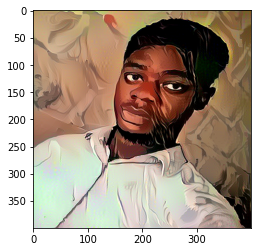

Start of iteration.  67
Current loss value:  228322350.0


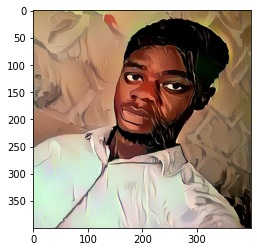

Start of iteration.  68
Current loss value:  227308240.0


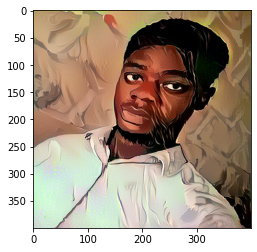

Start of iteration.  69
Current loss value:  226243020.0


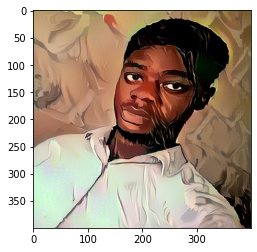

Start of iteration.  70
Current loss value:  225182640.0


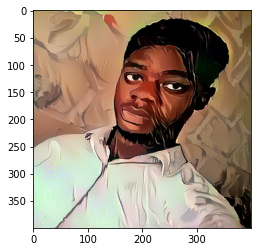

Start of iteration.  71
Current loss value:  224163060.0


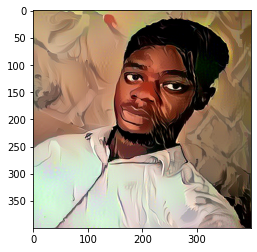

Start of iteration.  72
Current loss value:  223166060.0


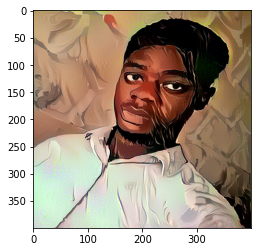

Start of iteration.  73
Current loss value:  222192600.0


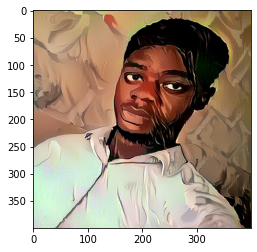

Start of iteration.  74
Current loss value:  221160620.0


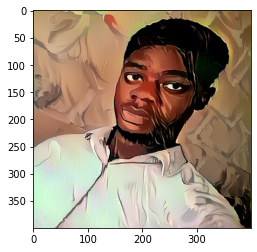

Start of iteration.  75
Current loss value:  220162980.0


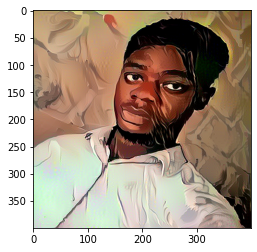

Start of iteration.  76
Current loss value:  219228700.0


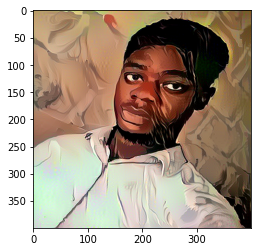

Start of iteration.  77
Current loss value:  218083730.0


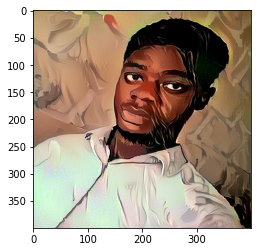

Start of iteration.  78
Current loss value:  216959420.0


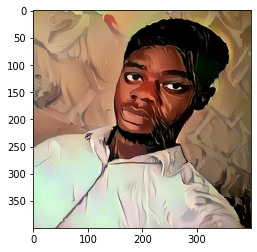

Start of iteration.  79
Current loss value:  216045710.0


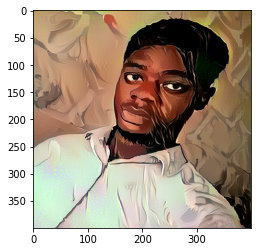

Start of iteration.  80
Current loss value:  215161000.0


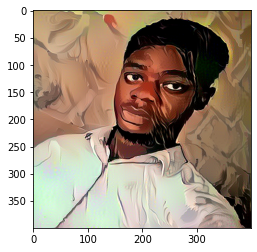

Start of iteration.  81
Current loss value:  214287150.0


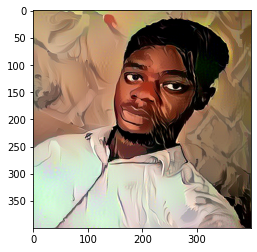

Start of iteration.  82
Current loss value:  213395580.0


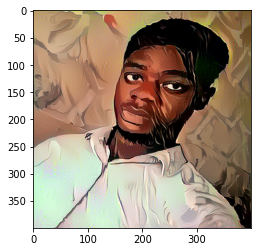

Start of iteration.  83
Current loss value:  212588980.0


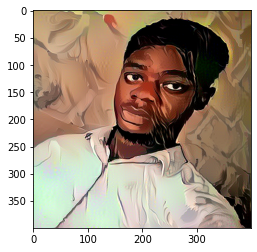

Start of iteration.  84
Current loss value:  211819630.0


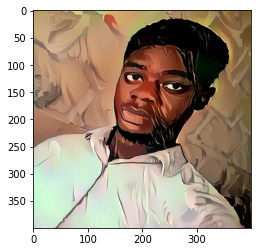

Start of iteration.  85
Current loss value:  210958350.0


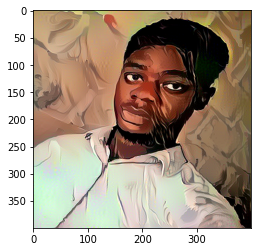

Start of iteration.  86
Current loss value:  210098030.0


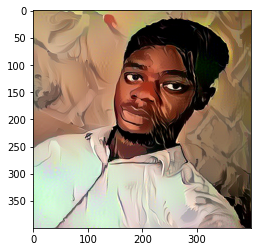

Start of iteration.  87
Current loss value:  209394270.0


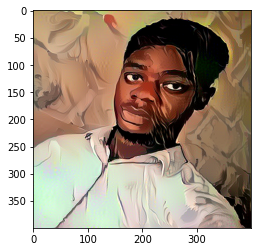

Start of iteration.  88
Current loss value:  208703250.0


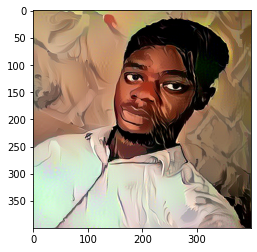

Start of iteration.  89
Current loss value:  208058830.0


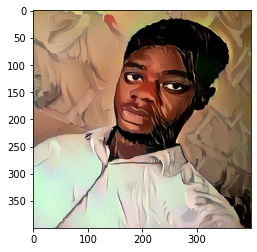

Start of iteration.  90
Current loss value:  207447790.0


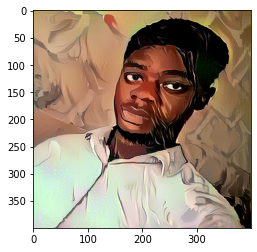

Start of iteration.  91
Current loss value:  206754140.0


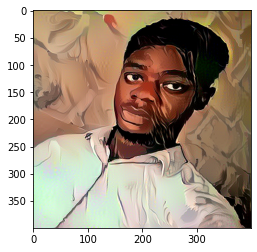

Start of iteration.  92
Current loss value:  206083200.0


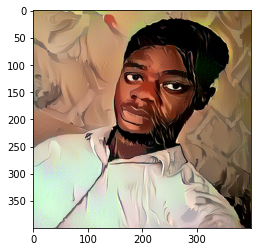

Start of iteration.  93
Current loss value:  205470080.0


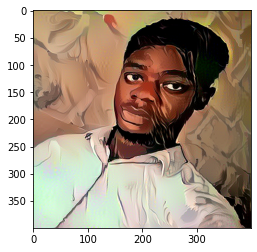

Start of iteration.  94
Current loss value:  204790190.0


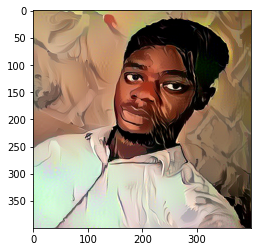

Start of iteration.  95
Current loss value:  204059920.0


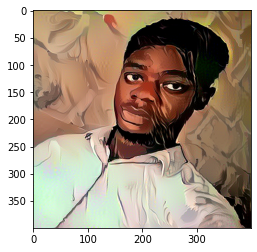

Start of iteration.  96
Current loss value:  203369650.0


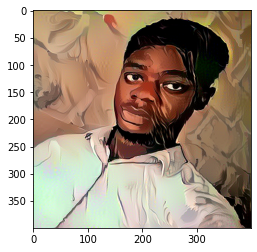

Start of iteration.  97
Current loss value:  202708860.0


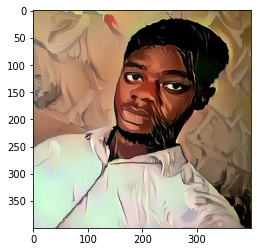

Start of iteration.  98
Current loss value:  202075800.0


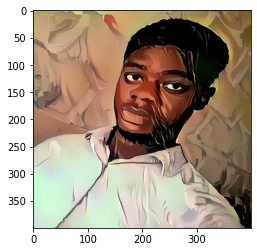

Start of iteration.  99
Current loss value:  201515920.0


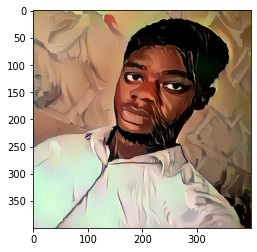

Start of iteration.  100
Current loss value:  200972380.0


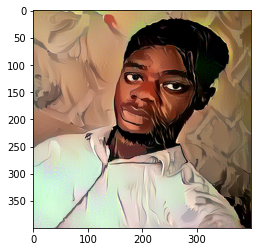

Start of iteration.  101
Current loss value:  200363950.0


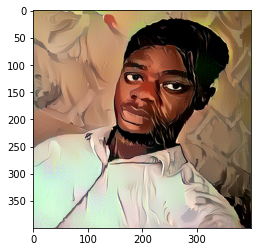

Start of iteration.  102
Current loss value:  199758780.0


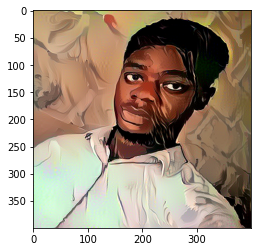

Start of iteration.  103
Current loss value:  199120370.0


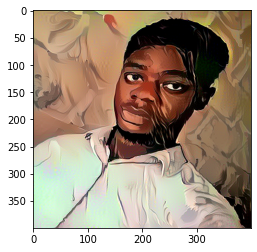

Start of iteration.  104
Current loss value:  198324380.0


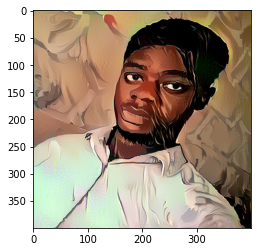

Start of iteration.  105
Current loss value:  197718340.0


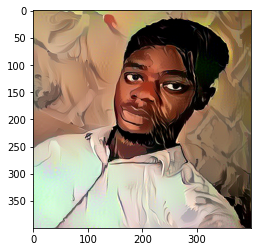

Start of iteration.  106
Current loss value:  197087660.0


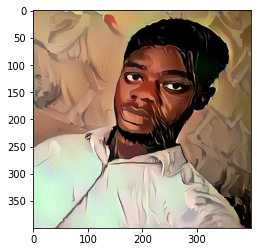

Start of iteration.  107
Current loss value:  196617820.0


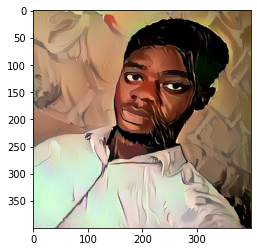

Start of iteration.  108
Current loss value:  196058340.0


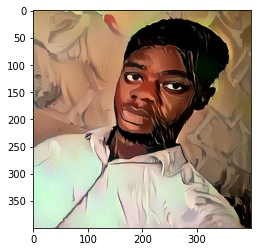

Start of iteration.  109
Current loss value:  195592560.0


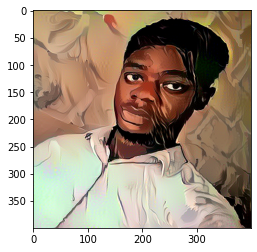

Start of iteration.  110
Current loss value:  195121520.0


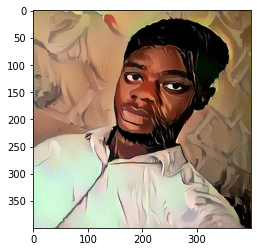

Start of iteration.  111
Current loss value:  194670370.0


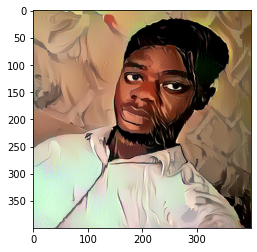

Start of iteration.  112
Current loss value:  194231420.0


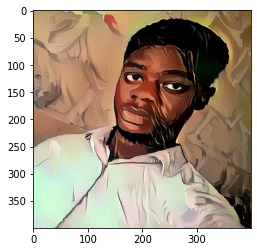

Start of iteration.  113
Current loss value:  193853600.0


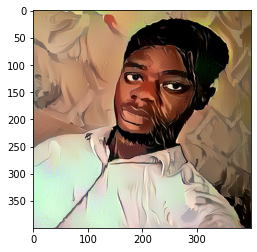

Start of iteration.  114
Current loss value:  193359890.0


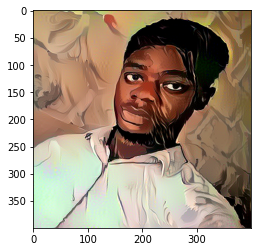

Start of iteration.  115
Current loss value:  192873060.0


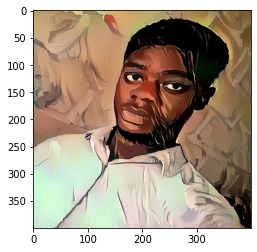

Start of iteration.  116
Current loss value:  192421920.0


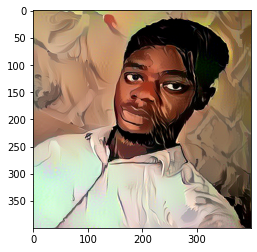

Start of iteration.  117
Current loss value:  192014190.0


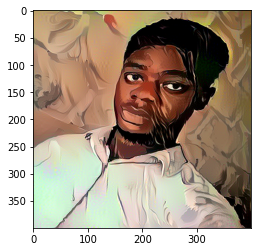

Start of iteration.  118
Current loss value:  191512200.0


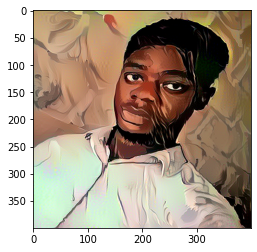

Start of iteration.  119
Current loss value:  191033660.0


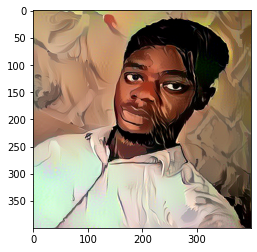

Start of iteration.  120
Current loss value:  190583700.0


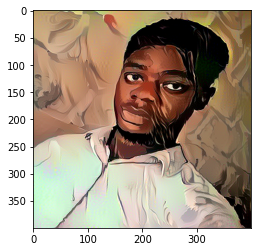

Start of iteration.  121
Current loss value:  190130720.0


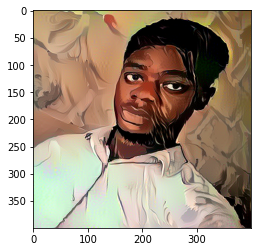

Start of iteration.  122
Current loss value:  189622990.0


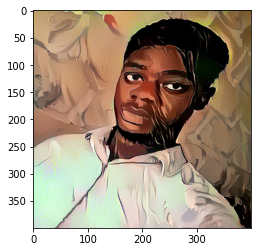

Start of iteration.  123
Current loss value:  189182640.0


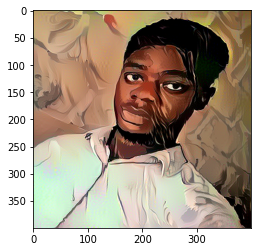

Start of iteration.  124
Current loss value:  188766380.0


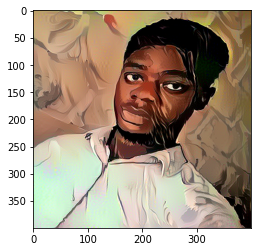

Start of iteration.  125
Current loss value:  188364210.0


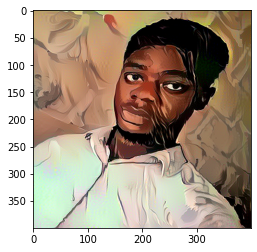

Start of iteration.  126
Current loss value:  187949220.0


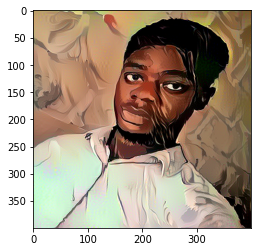

Start of iteration.  127
Current loss value:  187542510.0


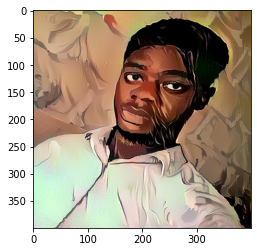

Start of iteration.  128
Current loss value:  187145250.0


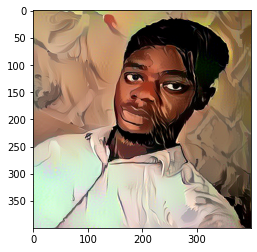

Start of iteration.  129
Current loss value:  186753140.0


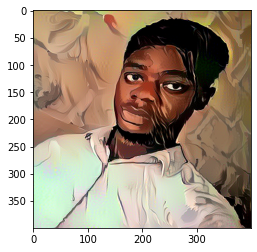

Start of iteration.  130
Current loss value:  186425200.0


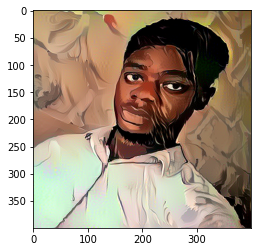

Start of iteration.  131
Current loss value:  186049180.0


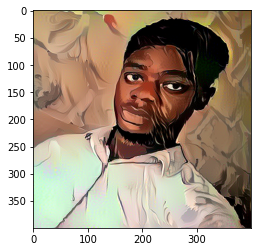

Start of iteration.  132
Current loss value:  185687170.0


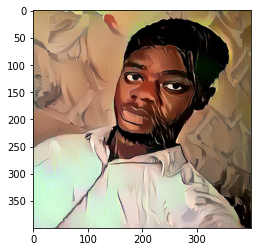

Start of iteration.  133
Current loss value:  185309680.0


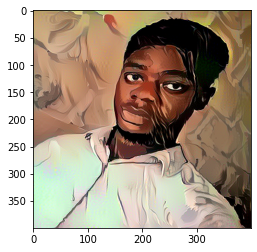

Start of iteration.  134
Current loss value:  184935870.0


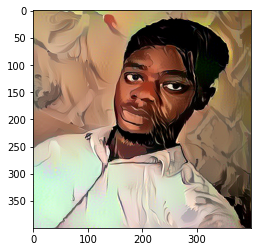

Start of iteration.  135
Current loss value:  184590880.0


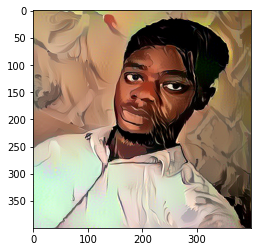

Start of iteration.  136
Current loss value:  184247680.0


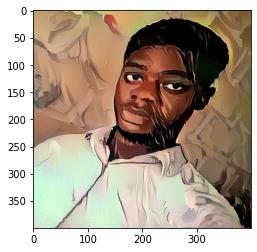

Start of iteration.  137
Current loss value:  183879920.0


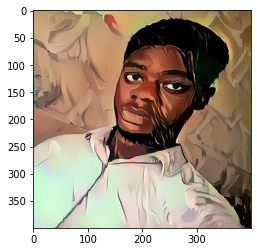

Start of iteration.  138
Current loss value:  183470080.0


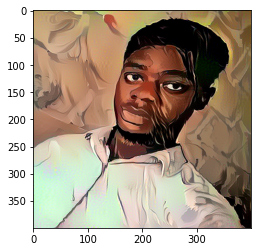

Start of iteration.  139
Current loss value:  183112980.0


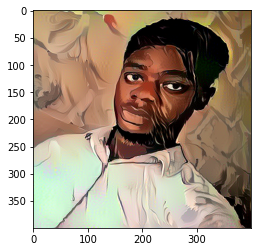

Start of iteration.  140
Current loss value:  182716370.0


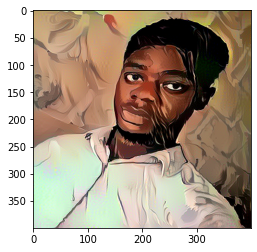

Start of iteration.  141
Current loss value:  182345900.0


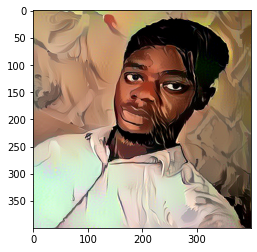

Start of iteration.  142
Current loss value:  181959600.0


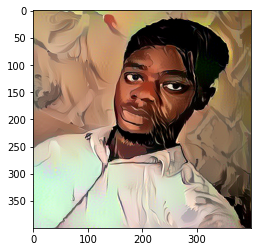

Start of iteration.  143
Current loss value:  181580720.0


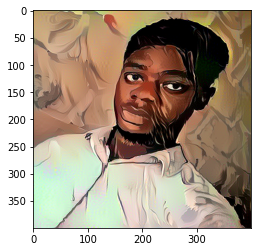

Start of iteration.  144
Current loss value:  181267780.0


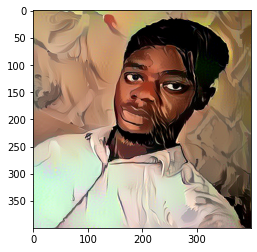

Start of iteration.  145
Current loss value:  180948700.0


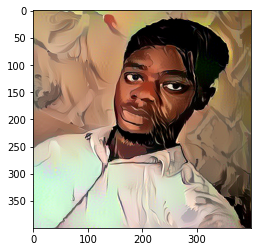

Start of iteration.  146
Current loss value:  180507100.0


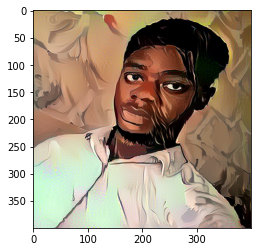

Start of iteration.  147
Current loss value:  180091060.0


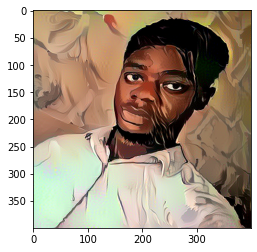

Start of iteration.  148
Current loss value:  179774660.0


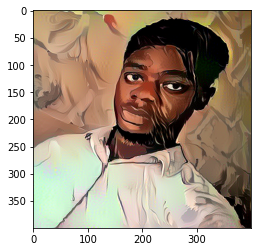

Start of iteration.  149
Current loss value:  179445180.0


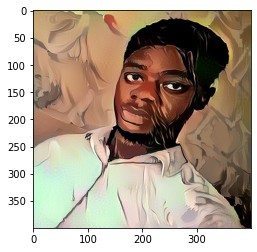

Start of iteration.  150
Current loss value:  179102450.0


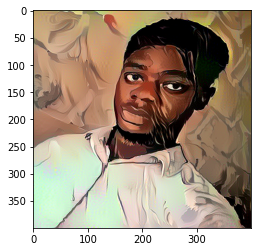

Start of iteration.  151
Current loss value:  178730620.0


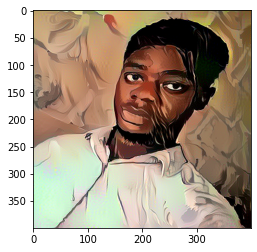

Start of iteration.  152
Current loss value:  178391950.0


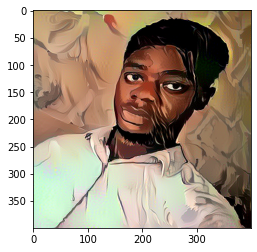

Start of iteration.  153
Current loss value:  178063300.0


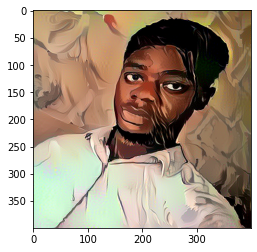

Start of iteration.  154
Current loss value:  177738100.0


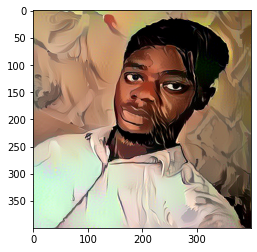

Start of iteration.  155
Current loss value:  177430580.0


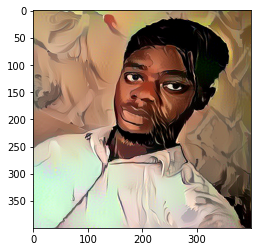

Start of iteration.  156
Current loss value:  177122940.0


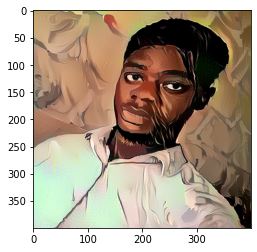

Start of iteration.  157
Current loss value:  176817730.0


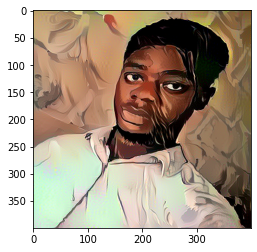

Start of iteration.  158
Current loss value:  176510160.0


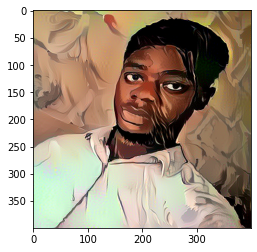

Start of iteration.  159
Current loss value:  176215780.0


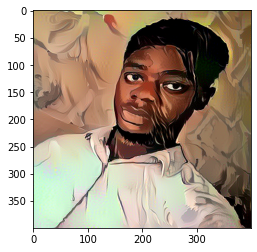

Start of iteration.  160
Current loss value:  175862020.0


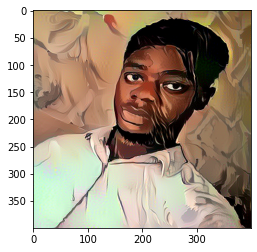

Start of iteration.  161
Current loss value:  175508130.0


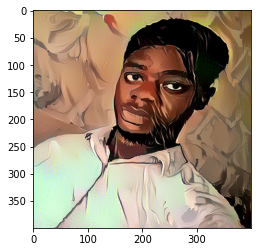

Start of iteration.  162
Current loss value:  175171710.0


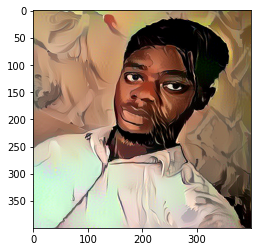

Start of iteration.  163
Current loss value:  174776960.0


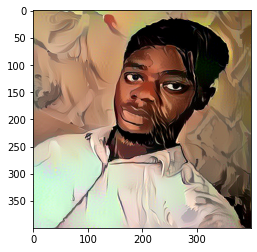

Start of iteration.  164
Current loss value:  174400210.0


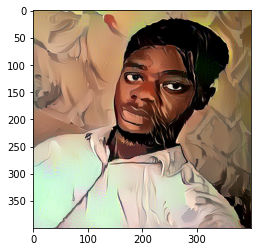

Start of iteration.  165
Current loss value:  174058610.0


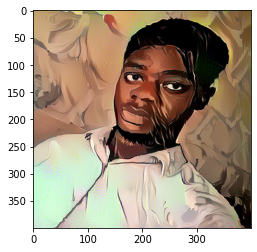

Start of iteration.  166
Current loss value:  173787760.0


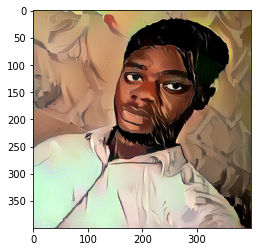

Start of iteration.  167
Current loss value:  173540000.0


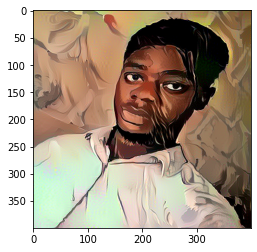

Start of iteration.  168
Current loss value:  173271460.0


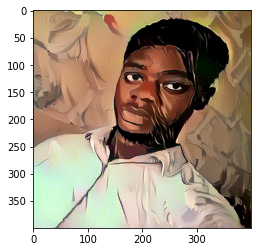

Start of iteration.  169
Current loss value:  173030830.0


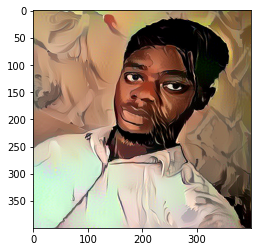

Start of iteration.  170
Current loss value:  172798080.0


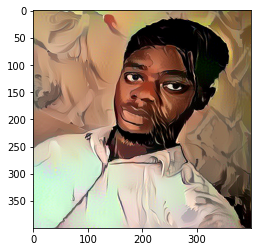

Start of iteration.  171
Current loss value:  172570910.0


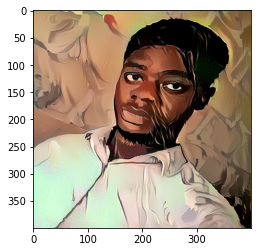

Start of iteration.  172
Current loss value:  172337920.0


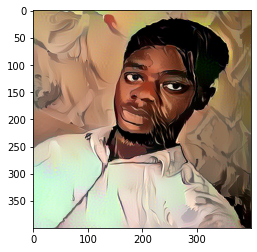

Start of iteration.  173
Current loss value:  172092050.0


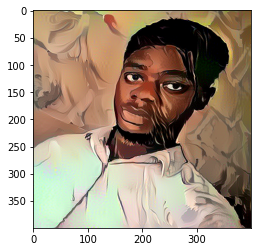

Start of iteration.  174
Current loss value:  171861340.0


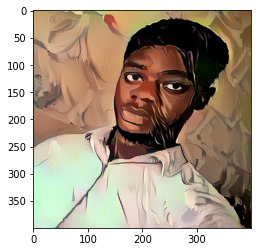

Start of iteration.  175
Current loss value:  171623200.0


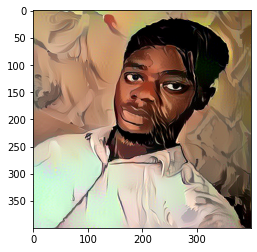

Start of iteration.  176
Current loss value:  171393700.0


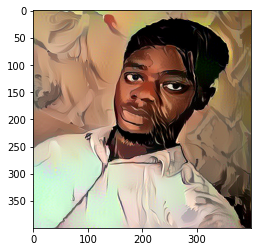

Start of iteration.  177
Current loss value:  171172600.0


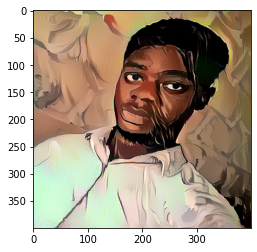

Start of iteration.  178
Current loss value:  170949810.0


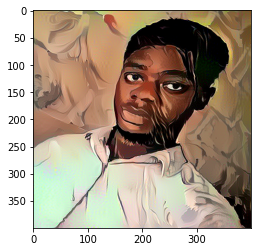

Start of iteration.  179
Current loss value:  170697120.0


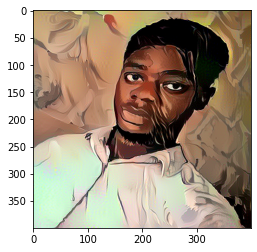

Start of iteration.  180
Current loss value:  170434780.0


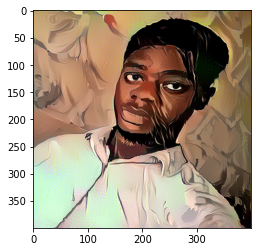

Start of iteration.  181
Current loss value:  170196940.0


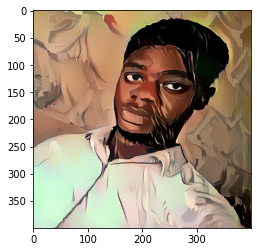

Start of iteration.  182
Current loss value:  169936420.0


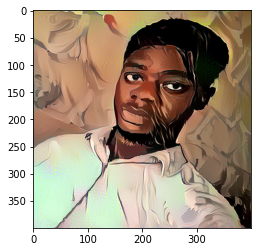

Start of iteration.  183
Current loss value:  169736690.0


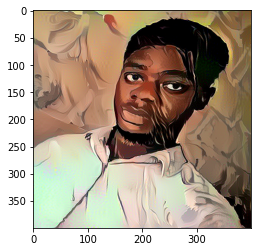

Start of iteration.  184
Current loss value:  169525740.0


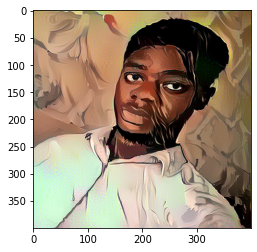

Start of iteration.  185
Current loss value:  169322340.0


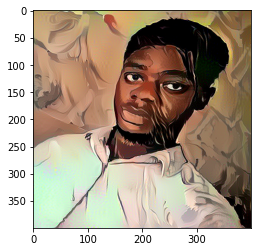

Start of iteration.  186
Current loss value:  169136740.0


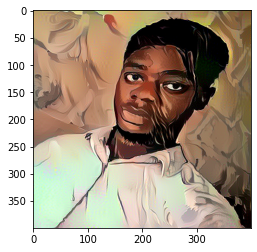

Start of iteration.  187
Current loss value:  168913150.0


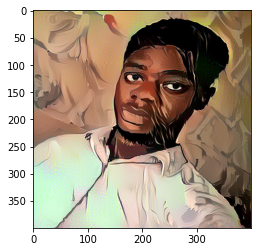

Start of iteration.  188
Current loss value:  168686930.0


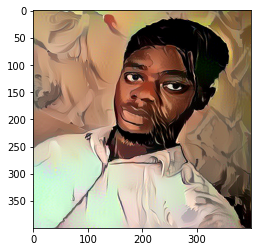

Start of iteration.  189
Current loss value:  168467800.0


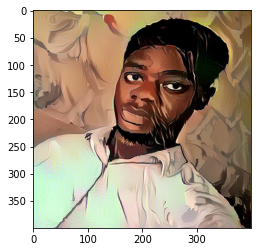

Start of iteration.  190
Current loss value:  168232720.0


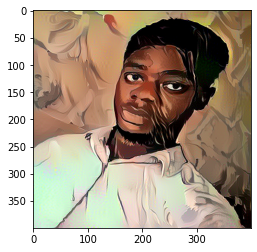

Start of iteration.  191
Current loss value:  168029020.0


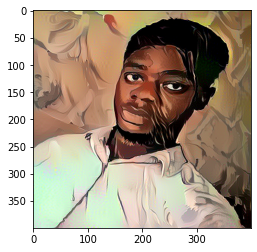

Start of iteration.  192
Current loss value:  167817600.0


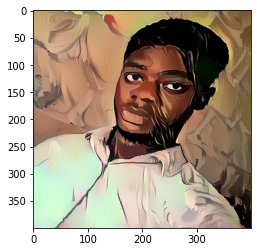

Start of iteration.  193
Current loss value:  167632260.0


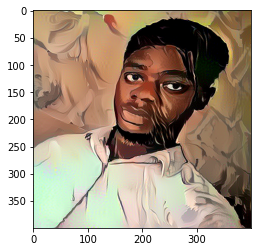

Start of iteration.  194
Current loss value:  167438080.0


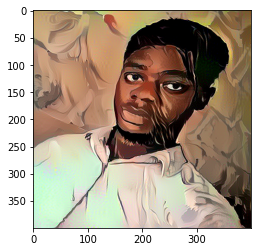

Start of iteration.  195
Current loss value:  167244100.0


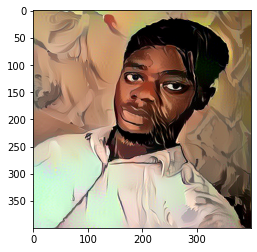

Start of iteration.  196
Current loss value:  167045800.0


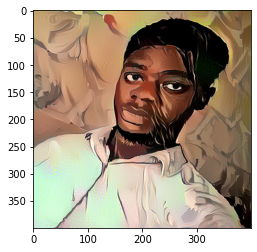

Start of iteration.  197
Current loss value:  166861090.0


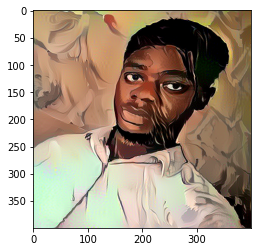

Start of iteration.  198
Current loss value:  166679280.0


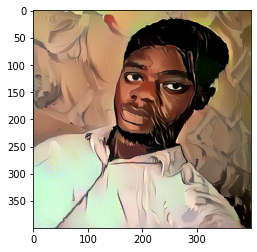

Start of iteration.  199
Current loss value:  166491120.0


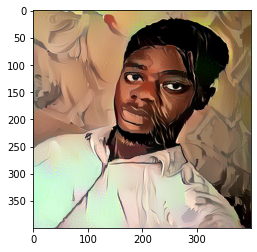

In [ ]:

from scipy.optimize import fmin_l_bfgs_b
import matplotlib.pyplot as plt
import time

x = target_image
x = x.flatten()
x = x.flatten()
print(x.shape)
for i in range(200):
  print("Start of iteration. ", i)
  start_time = time.time()
  x, min_val, info = fmin_l_bfgs_b(func = evaluator.loss, x0 = x, fprime = evaluator.grads, maxfun = 20, factr = 10, maxiter = 10)
  print("Current loss value: ", min_val)
  img = x.copy().reshape((400, 400 ,3))
  img = deprocess_image(img)
  plt.imshow(img)
  plt.show()
  end_time = time.time()
